In [76]:
import os
import tensorflow as tf

In [51]:
gtPath = "_conv2/"
rgbPath = "_out/"

gtFileNames = os.listdir(gtPath)
outFileNames = os.listdir(rgbPath)

matchingFiles = set(outFileNames) & set(gtFileNames)

In [54]:
NumTrainingImages = 10000
StartingIndex = 0

import random

FileNames = random.sample(matchingFiles, NumTrainingImages)

                            
gtFileNames = gtFileNames[StartingIndex:StartingIndex+NumTrainingImages]
outFileNames = outFileNames [StartingIndex:StartingIndex+NumTrainingImages]

for i in range(0,NumTrainingImages):
    gtFileNames[i] = gtPath + FileNames[i]
    outFileNames[i] = rgbPath + FileNames[i]
    

C:\Users\danie\AppData\Local\Temp\ipykernel_13236\894075362.py:6: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  FileNames = random.sample(matchingFiles, NumTrainingImages)


In [79]:
len(gtFileNames)

10000

In [80]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(outFileNames, gtFileNames, test_size=0.2, random_state=1)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1) # 0.25 x 0.8 = 0.2

In [81]:
def loadImage(outPath, gtPath):
    
    img = tf.io.read_file(outPath)
    img = tf.image.decode_png(img, channels=3)
    img = tf.cast(img, tf.float32) / 255.0
    img = img[:1000, :, :] # Crop the bonnet
    img = tf.image.resize(img, (256, 256), method='nearest')
    

    mask = tf.io.read_file(gtPath)
    #mask = tf.image.decode_png(mask, channels=1)
    mask = tf.image.decode_png(mask, channels=3)
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = mask[:1000, :, :] # Crop the bonnet
    mask = tf.image.resize(mask, (256, 256), method='nearest')
    
    return img, mask

In [82]:
batchSize = 32
bufferSize = 500

def genDataset(outPath, gtPath, bufferSize, batchSize):
    
    imageList = tf.constant(outPath) 
    maskList = tf.constant(gtPath)
    dataset = tf.data.Dataset.from_tensor_slices((imageList, maskList))
    dataset = dataset.map(loadImage, num_parallel_calls=tf.data.AUTOTUNE)
    
    dataset = dataset.cache().shuffle(bufferSize).batch(batchSize)
    
    return dataset

In [83]:
trainDataset = genDataset(X_train, y_train, bufferSize, batchSize)
valDataset = genDataset(X_val, y_val, bufferSize, batchSize)
testDataset = genDataset(X_test, y_test, bufferSize, batchSize)

In [84]:
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Activation, Input, Conv2D, MaxPooling2D, BatchNormalization, Conv2DTranspose, concatenate
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau



def encoderBlock(inputs, filters, maxPool=True):
    
    X = Conv2D(filters, 3, padding="same")(inputs)
    X = BatchNormalization()(X)
    X = Activation("relu")(X)

    X = Conv2D(filters, 3, padding="same")(X)
    X = BatchNormalization()(X)
    X = Activation("relu")(X)

    skip = X
    
    if maxPool:
        X = MaxPooling2D(pool_size=(2, 2))(X)        

    return X, skip

In [85]:
def decoderBlock(inputs, skip, filters):
    
    X = Conv2DTranspose(filters, 3, strides=(2,2), padding="same")(inputs) 
    
    X = concatenate([X, skip], axis=3) #concat prev skip connection

    X = Conv2D(filters, 3, padding="same")(X)
    X = BatchNormalization()(X)
    X = Activation("relu")(X)
    
    X = Conv2D(filters, 3, padding="same")(X)
    X = BatchNormalization()(X)
    X = Activation("relu")(X)
    
  
    return X

In [86]:
def unet(inputShape, filters, labels):
    
    inputs = Input(inputShape)
        
    # Encoder
    X1, S1 = encoderBlock(inputs, filters, maxPool=True)
    X2, S2 = encoderBlock(X1, filters * 2, maxPool=True)
    X3, S3 = encoderBlock(X2, filters * 4, maxPool=True)
    X4, S4 = encoderBlock(X3, filters * 8, maxPool=True)
    
    X5, S5 = encoderBlock(X4, filters * 16, maxPool=False)
    
    # Decoder
    X6 = decoderBlock(X5, S4, filters * 8)
    X7 = decoderBlock(X6, S3,  filters * 4)
    X8 = decoderBlock(X7, S2,  filters = filters * 2)
    X9 = decoderBlock(X8, S1,  filters = filters)

    X10 = Conv2D(filters, 3,activation='relu', padding='same')(X9)

 
    X11 = Conv2D(filters = labels, kernel_size = (1,1), activation='sigmoid', padding='same')(X10)
    
    modelUnet = Model(inputs=inputs, outputs=X11)

    return modelUnet

In [87]:
imgShape = (256,256,3)

filters = 32
labels = 32 # True/False

modelUnet = unet(imgShape, filters, labels)
modelUnet.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_120 (Conv2D)            (None, 256, 256, 32  896         ['input_7[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_108 (Batch  (None, 256, 256, 32  128        ['conv2d_120[0][0]']             
 Normalization)                 )                                                           

In [88]:
modelUnet.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])
ES = EarlyStopping(monitor='val_accuracy', patience=15, restore_best_weights=True)
reduceLR = ReduceLROnPlateau(monitor='val_accuracy',factor=1e-1, patience=5, verbose=1, min_lr = 2e-6)

epochs = 30

In [89]:
historyUnet = modelUnet.fit(trainDataset, 
                    validation_data = valDataset, 
                    epochs = epochs, 
                    verbose=1, 
                    callbacks = [ES, reduceLR], 
                    batch_size = batchSize, 
                    shuffle = True)

Epoch 1/30


InvalidArgumentError: Graph execution error:

Detected at node 'sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits' defined at (most recent call last):
    File "C:\Users\danie\.conda\envs\tf\lib\runpy.py", line 197, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "C:\Users\danie\.conda\envs\tf\lib\runpy.py", line 87, in _run_code
      exec(code, run_globals)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\traitlets\config\application.py", line 1077, in launch_instance
      app.start()
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\kernelapp.py", line 737, in start
      self.io_loop.start()
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\tornado\platform\asyncio.py", line 215, in start
      self.asyncio_loop.run_forever()
    File "C:\Users\danie\.conda\envs\tf\lib\asyncio\base_events.py", line 601, in run_forever
      self._run_once()
    File "C:\Users\danie\.conda\envs\tf\lib\asyncio\base_events.py", line 1905, in _run_once
      handle._run()
    File "C:\Users\danie\.conda\envs\tf\lib\asyncio\events.py", line 80, in _run
      self._context.run(self._callback, *self._args)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\kernelbase.py", line 524, in dispatch_queue
      await self.process_one()
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\kernelbase.py", line 513, in process_one
      await dispatch(*args)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\kernelbase.py", line 418, in dispatch_shell
      await result
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\kernelbase.py", line 758, in execute_request
      reply_content = await reply_content
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\ipkernel.py", line 426, in do_execute
      res = shell.run_cell(
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\ipykernel\zmqshell.py", line 549, in run_cell
      return super().run_cell(*args, **kwargs)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\IPython\core\interactiveshell.py", line 3048, in run_cell
      result = self._run_cell(
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\IPython\core\interactiveshell.py", line 3103, in _run_cell
      result = runner(coro)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\IPython\core\async_helpers.py", line 129, in _pseudo_sync_runner
      coro.send(None)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\IPython\core\interactiveshell.py", line 3308, in run_cell_async
      has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\IPython\core\interactiveshell.py", line 3490, in run_ast_nodes
      if await self.run_code(code, result, async_=asy):
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\IPython\core\interactiveshell.py", line 3550, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "C:\Users\danie\AppData\Local\Temp\ipykernel_23516\4052556839.py", line 1, in <module>
      historyUnet = modelUnet.fit(trainDataset,
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\utils\traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\training.py", line 1564, in fit
      tmp_logs = self.train_function(iterator)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\training.py", line 1160, in train_function
      return step_function(self, iterator)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\training.py", line 1146, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\training.py", line 1135, in run_step
      outputs = model.train_step(data)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\training.py", line 994, in train_step
      loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\training.py", line 1052, in compute_loss
      return self.compiled_loss(
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\engine\compile_utils.py", line 265, in __call__
      loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\losses.py", line 152, in __call__
      losses = call_fn(y_true, y_pred)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\losses.py", line 272, in call
      return ag_fn(y_true, y_pred, **self._fn_kwargs)
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\losses.py", line 2084, in sparse_categorical_crossentropy
      return backend.sparse_categorical_crossentropy(
    File "C:\Users\danie\.conda\envs\tf\lib\site-packages\keras\backend.py", line 5630, in sparse_categorical_crossentropy
      res = tf.nn.sparse_softmax_cross_entropy_with_logits(
Node: 'sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits'
logits and labels must have the same first dimension, got logits shape [2097152,32] and labels shape [6291456]
	 [[{{node sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits}}]] [Op:__inference_train_function_40344]

In [ ]:
import matplotlib.pyplot as plt


acc = [0.] + historyUnet.history['accuracy']
val_acc = [0.] + historyUnet.history['val_accuracy']

loss = historyUnet.history['loss']
val_loss = historyUnet.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [17]:
import tensorflow as tf

if 'modelUnet' not in globals():
    modelUnet = tf.keras.modelUnets.load_modelUnet('Unet1.0.h5')

else:
    modelUnet.save('Unet2.0.h5')



In [18]:
train_loss, train_accuracy = modelUnet.evaluate(trainDataset, batch_size = 32)
validation_loss, validation_accuracy = modelUnet.evaluate(valDataset, batch_size = 32)
test_loss, test_accuracy = modelUnet.evaluate(testDataset, batch_size = 32)

print(f'modelUnet Accuracy on the Training Dataset: {round(train_accuracy * 100, 2)}%')
print(f'modelUnet Accuracy on the Validation Dataset: {round(validation_accuracy * 100, 2)}%')
print(f'modelUnet Accuracy on the Test Dataset: {round(test_accuracy * 100, 2)}%')

63/63 [==============================] - 36s 490ms/step - loss: 0.0101 - accuracy: 0.9966
modelUnet Accuracy on the Training Dataset: 99.66%
modelUnet Accuracy on the Validation Dataset: 99.63%
modelUnet Accuracy on the Test Dataset: 99.66%


In [19]:
def display(display_list):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

In [20]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask[0]


1/1 [==============================] - 1s 514ms/step


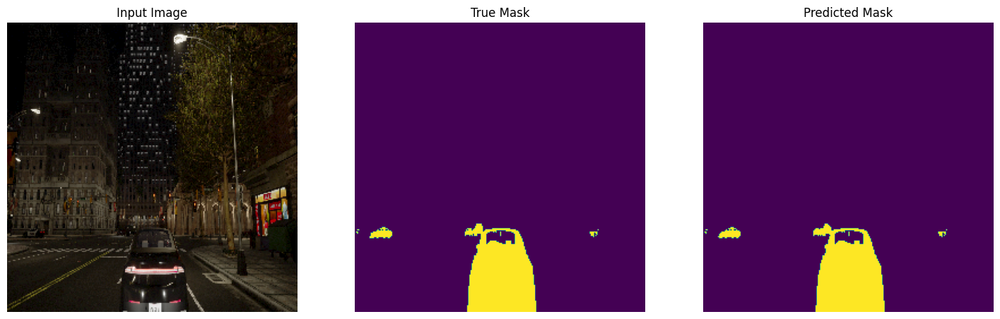

1/1 [==============================] - 0s 23ms/step


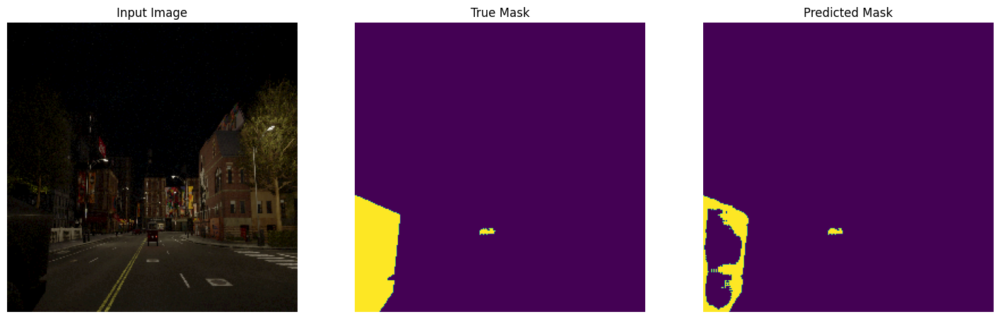

1/1 [==============================] - 0s 24ms/step


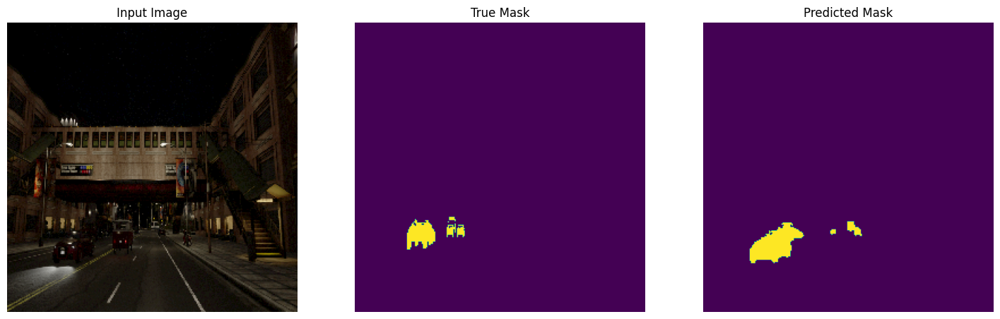

1/1 [==============================] - 0s 25ms/step


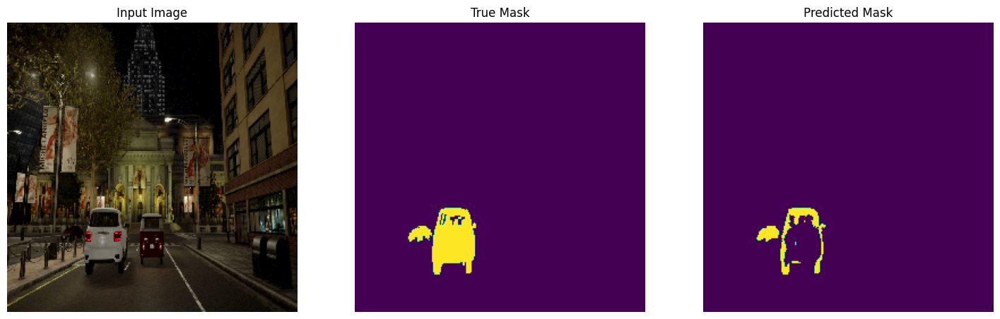

1/1 [==============================] - 0s 23ms/step


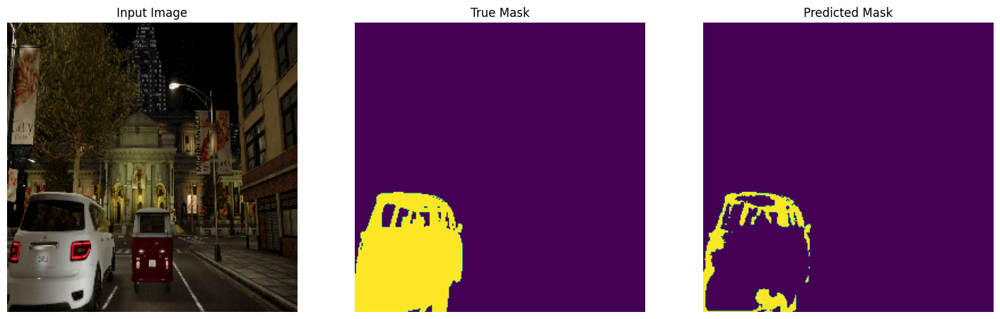

1/1 [==============================] - 0s 23ms/step


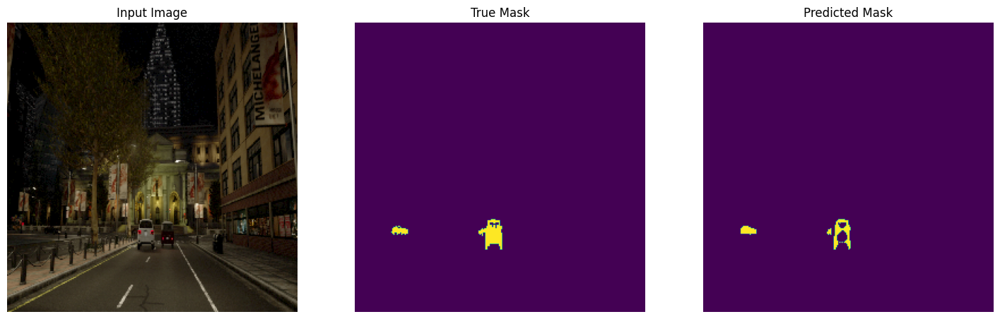

1/1 [==============================] - 0s 22ms/step


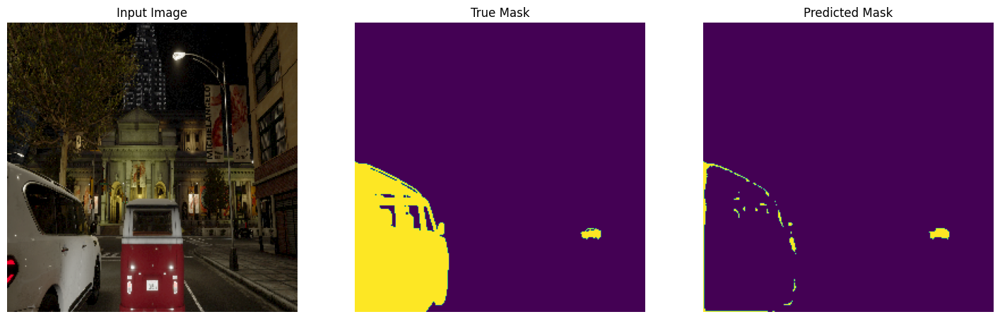

1/1 [==============================] - 0s 26ms/step


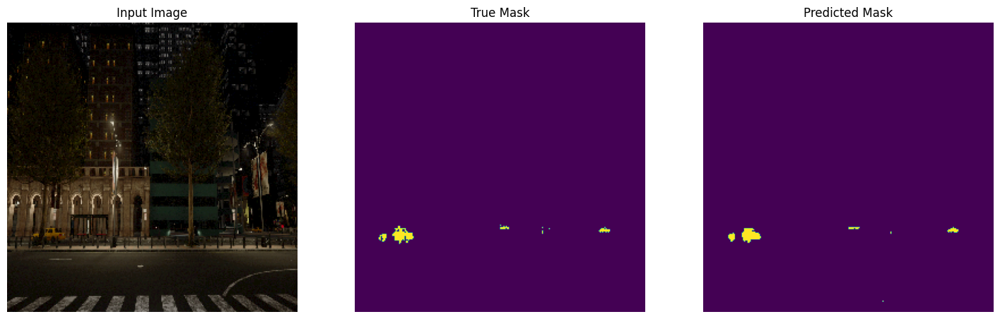

1/1 [==============================] - 0s 25ms/step


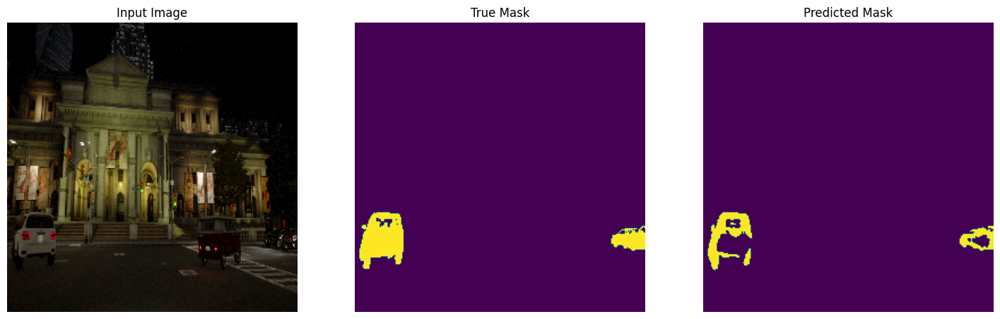

1/1 [==============================] - 0s 26ms/step


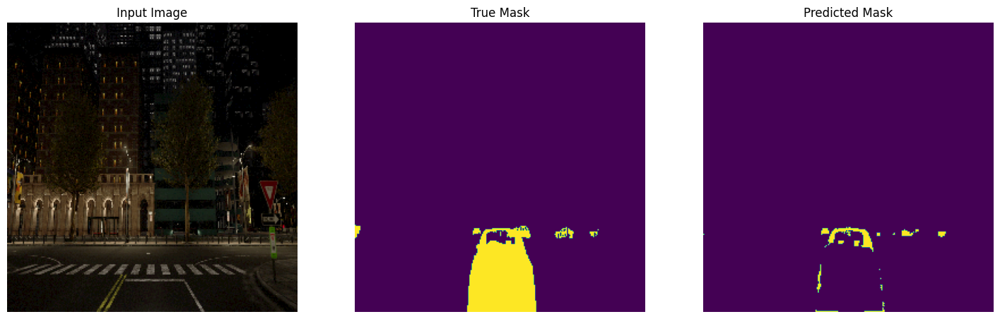

1/1 [==============================] - 0s 22ms/step


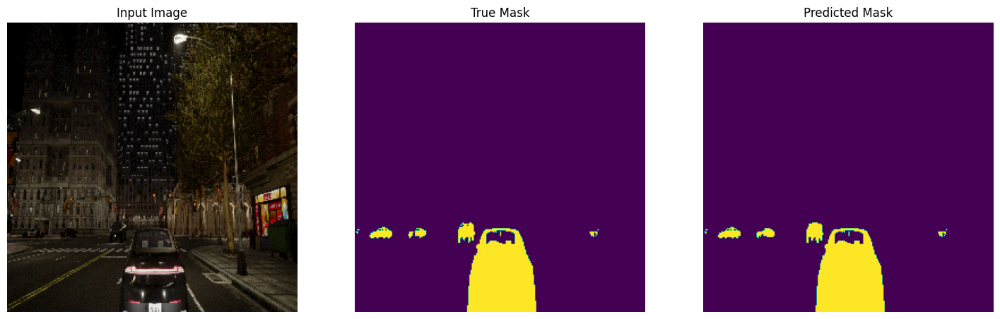

1/1 [==============================] - 0s 23ms/step


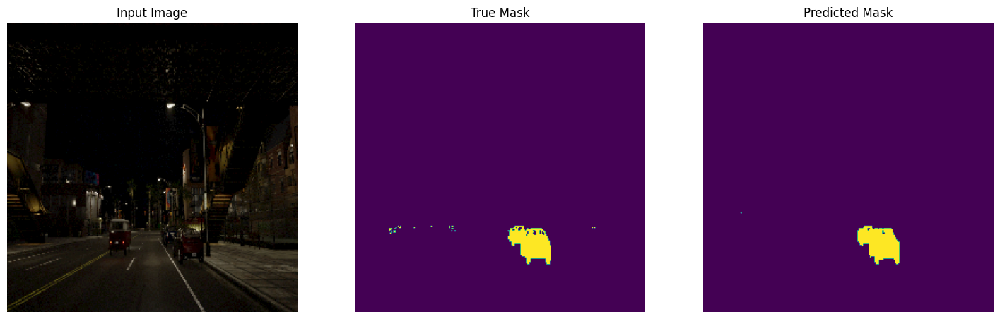

1/1 [==============================] - 0s 22ms/step


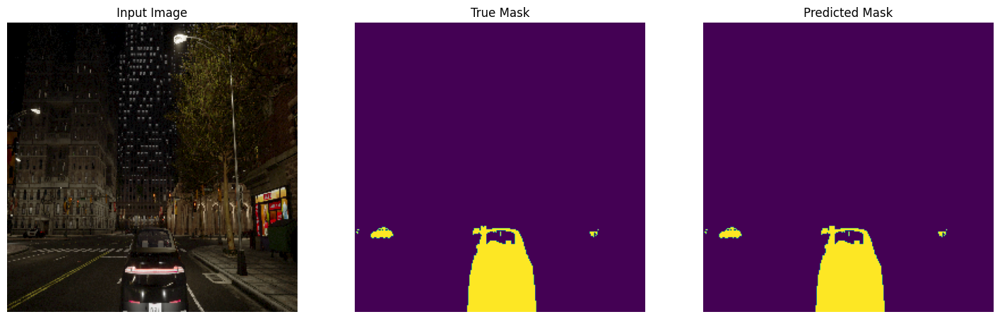

1/1 [==============================] - 0s 23ms/step


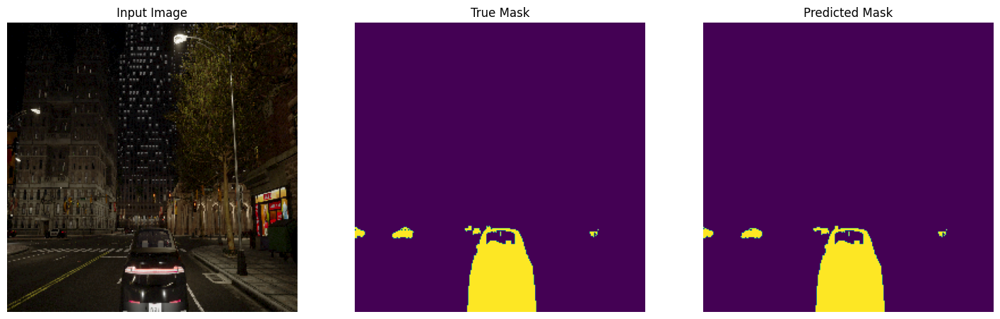

1/1 [==============================] - 0s 26ms/step


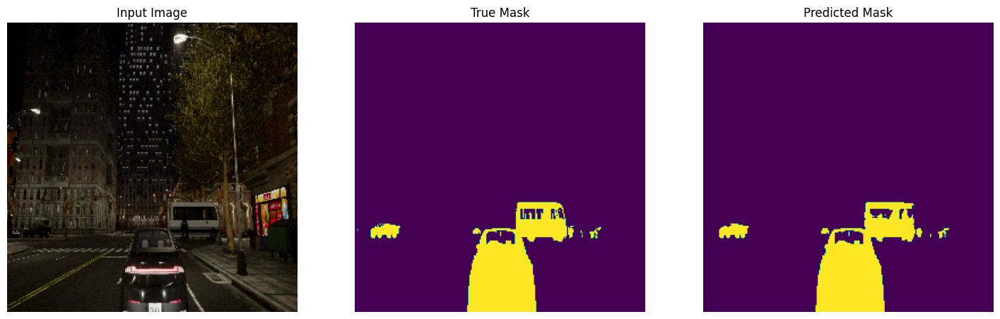

1/1 [==============================] - 0s 22ms/step


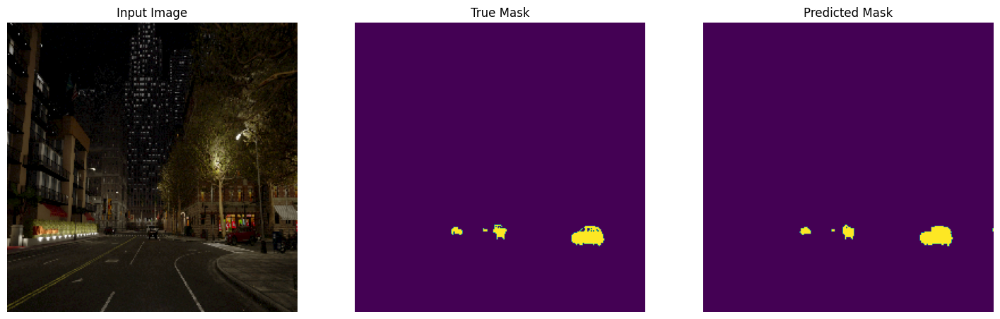

1/1 [==============================] - 0s 22ms/step


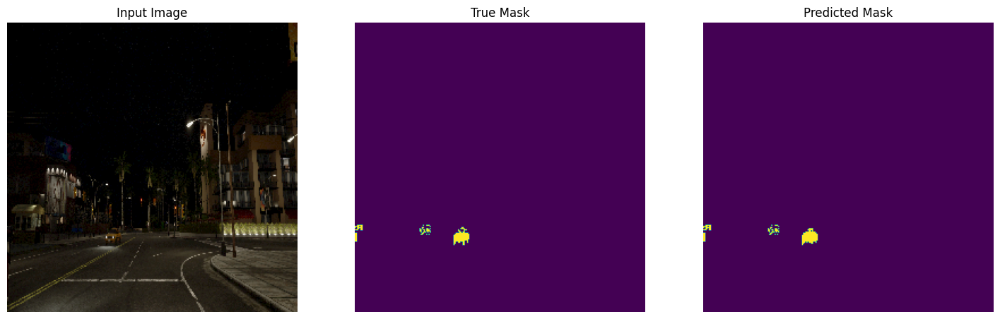

1/1 [==============================] - 0s 22ms/step


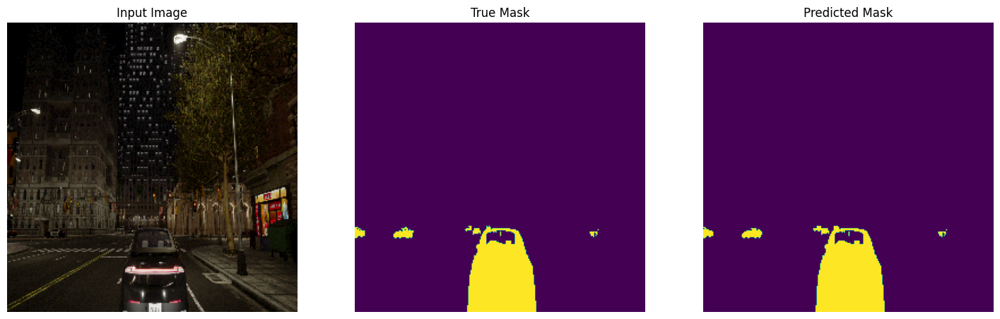

1/1 [==============================] - 0s 23ms/step


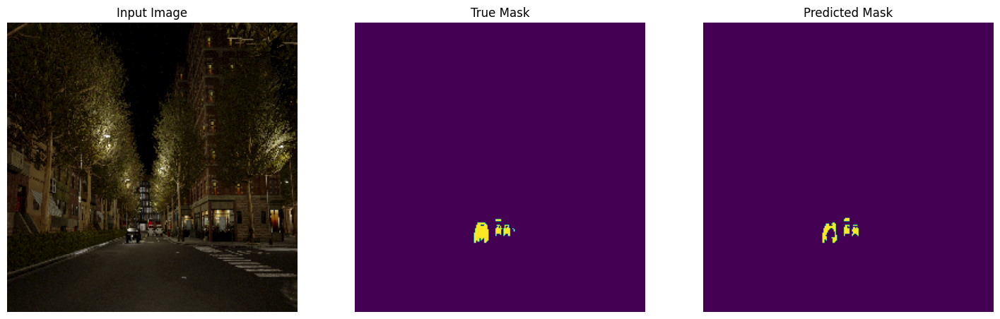

1/1 [==============================] - 0s 23ms/step


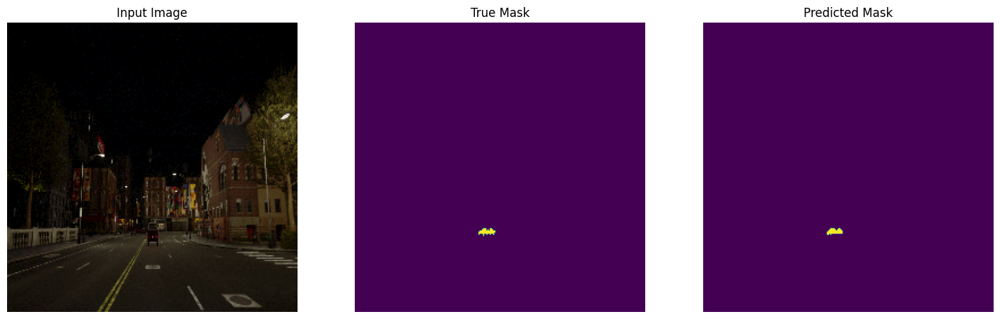

1/1 [==============================] - 0s 27ms/step


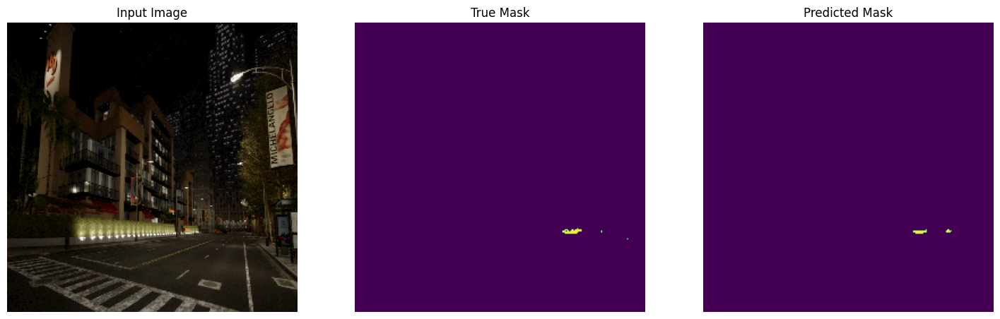

1/1 [==============================] - 0s 23ms/step


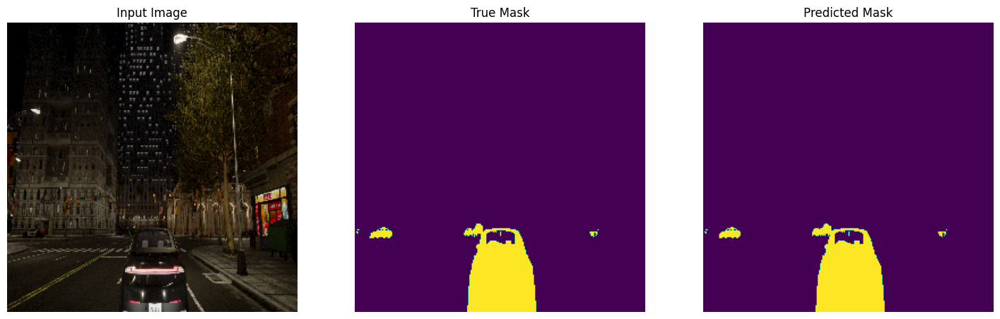

1/1 [==============================] - 0s 22ms/step


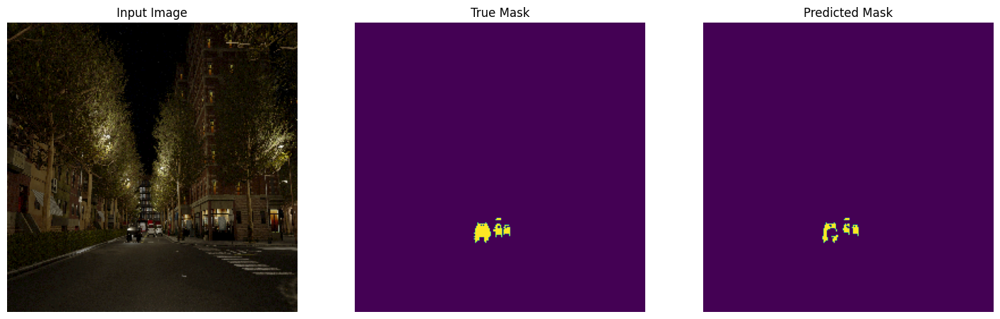

1/1 [==============================] - 0s 23ms/step


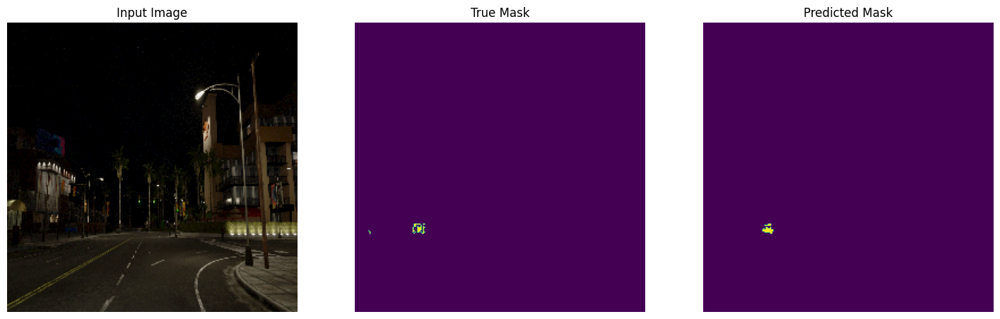

1/1 [==============================] - 0s 23ms/step


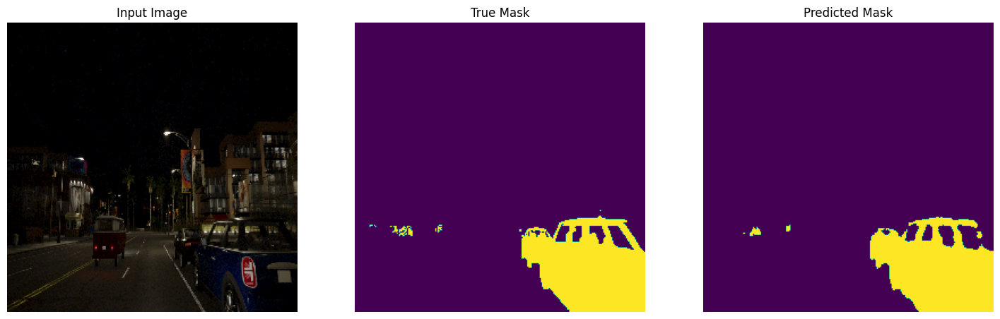

1/1 [==============================] - 0s 22ms/step


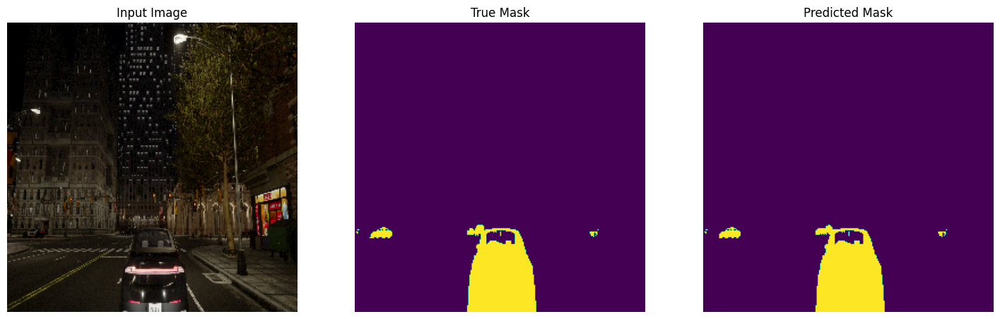

1/1 [==============================] - 0s 22ms/step


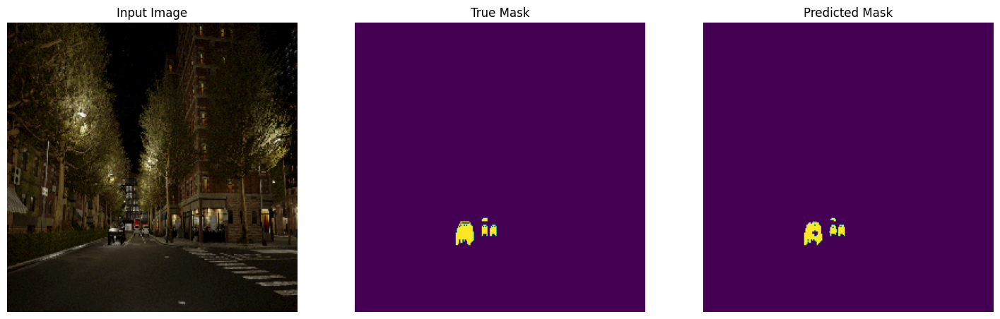

1/1 [==============================] - 0s 23ms/step


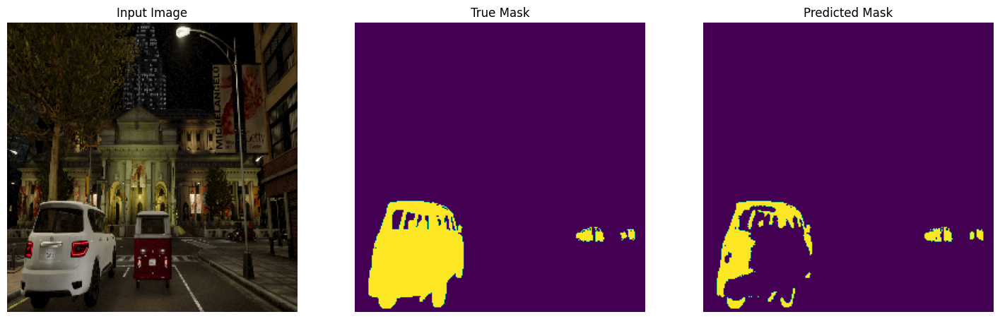

1/1 [==============================] - 0s 22ms/step


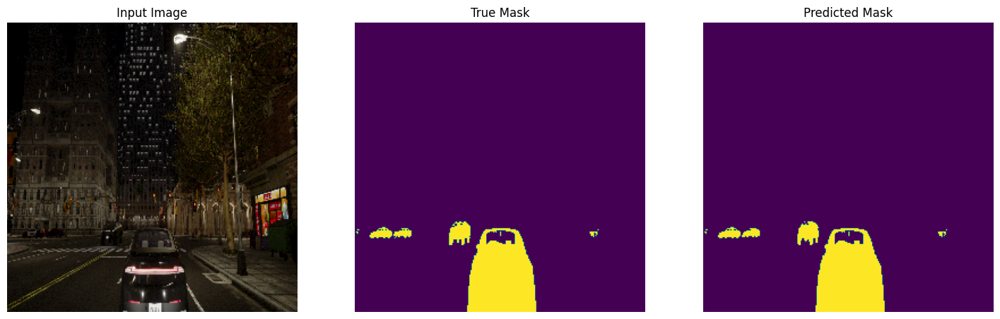

1/1 [==============================] - 0s 23ms/step


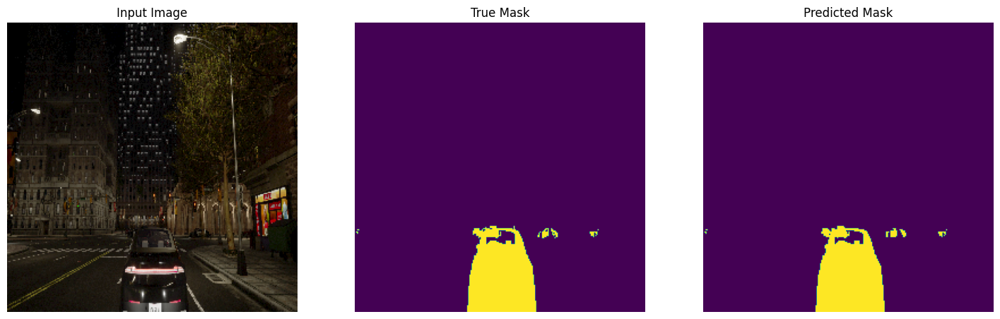

1/1 [==============================] - 0s 23ms/step


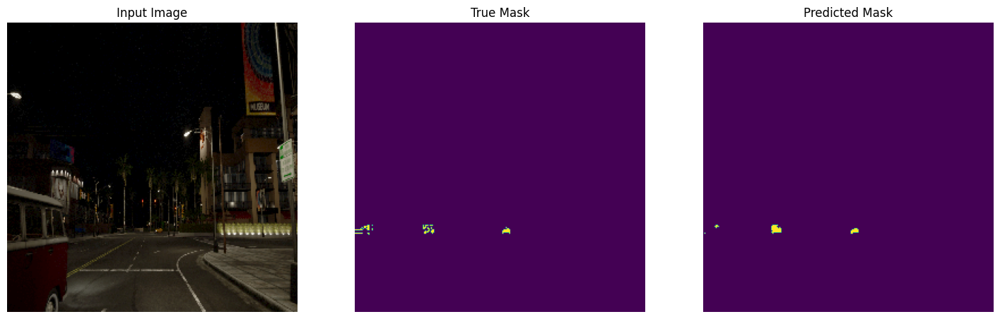

1/1 [==============================] - 0s 23ms/step


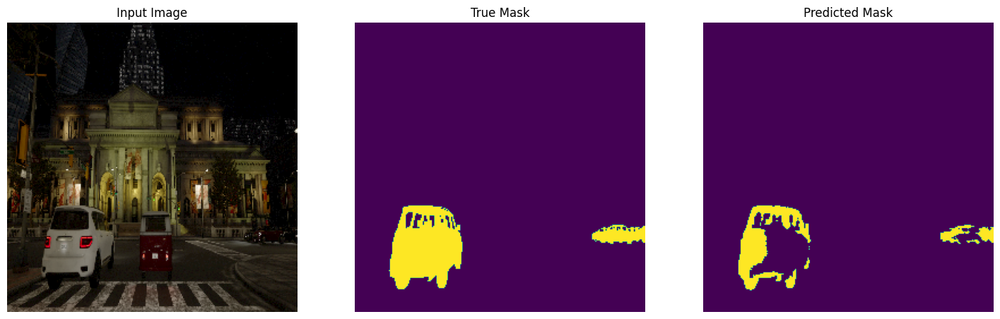

1/1 [==============================] - 0s 28ms/step


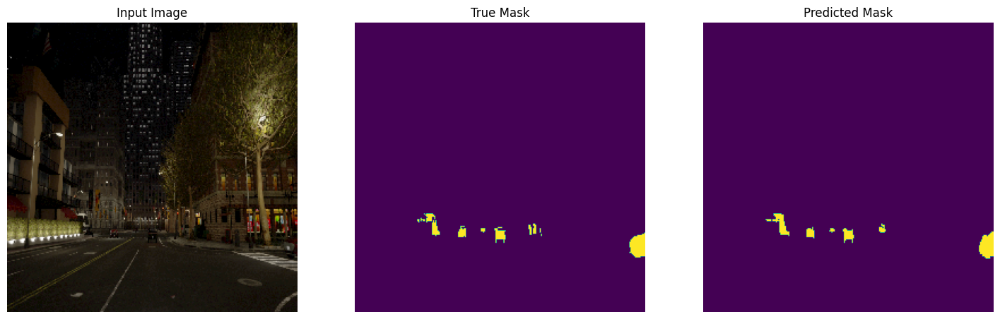

1/1 [==============================] - 0s 22ms/step


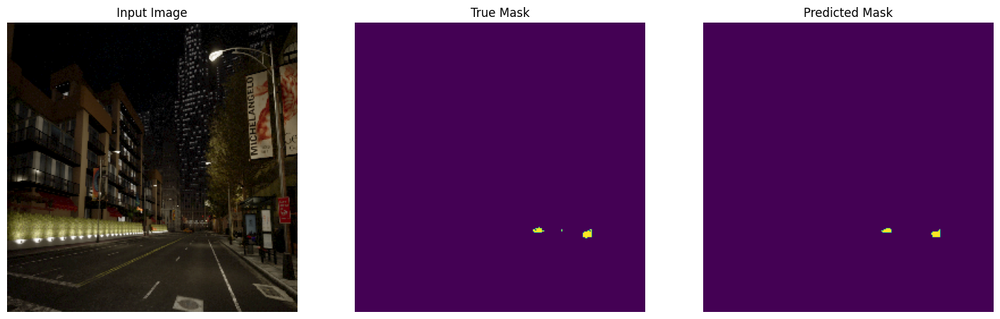

1/1 [==============================] - 0s 22ms/step


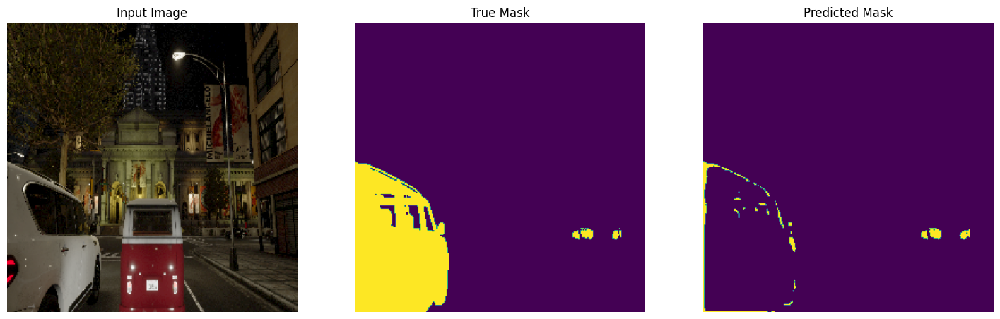

1/1 [==============================] - 0s 25ms/step


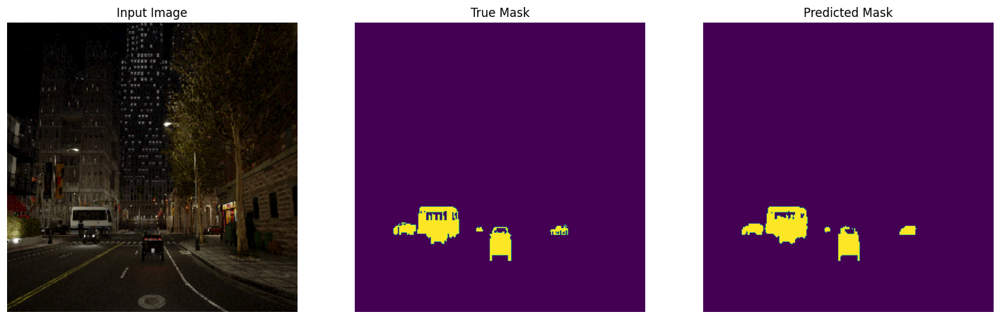

1/1 [==============================] - 0s 23ms/step


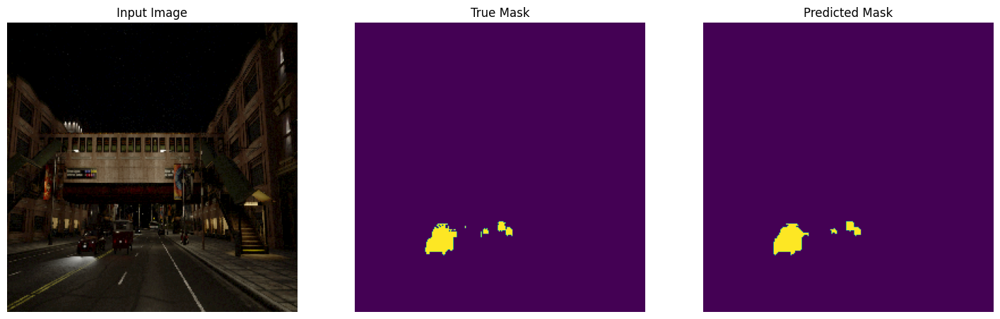

1/1 [==============================] - 0s 23ms/step


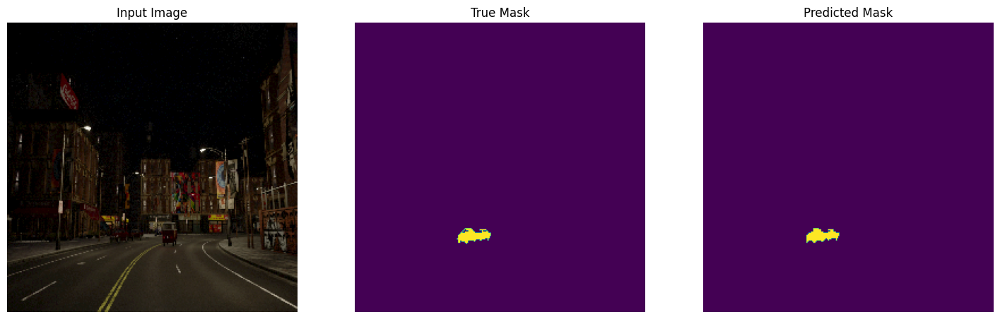

1/1 [==============================] - 0s 24ms/step


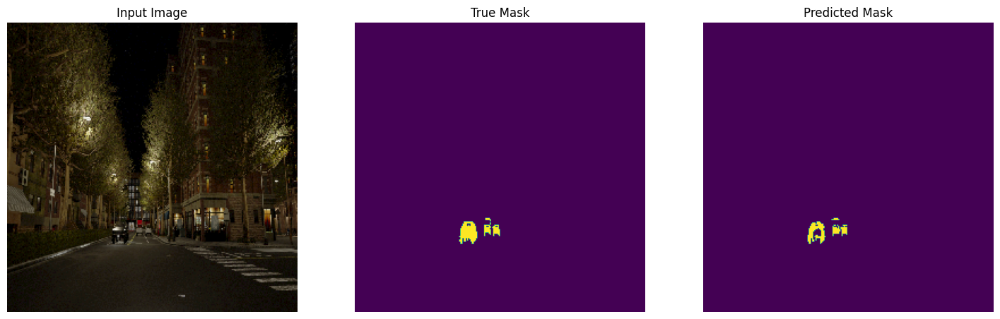

1/1 [==============================] - 0s 22ms/step


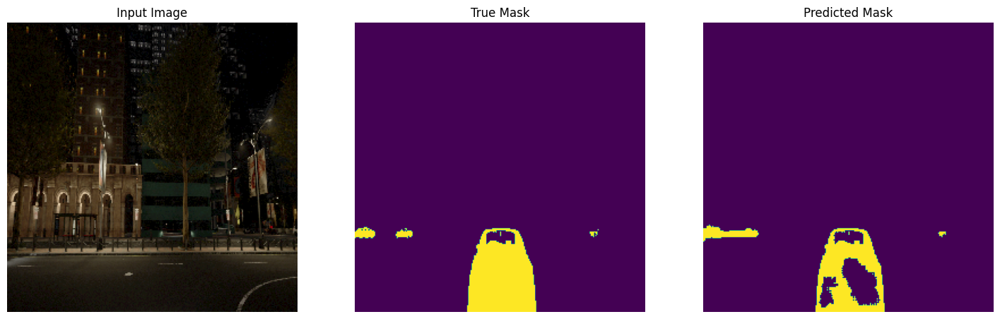

1/1 [==============================] - 0s 22ms/step


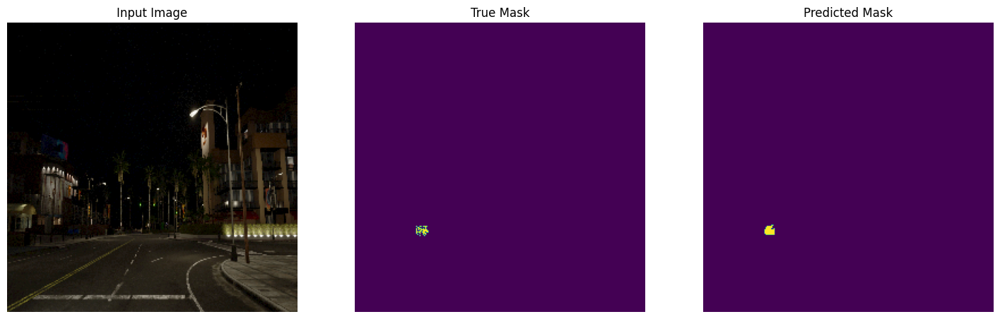

1/1 [==============================] - 0s 22ms/step


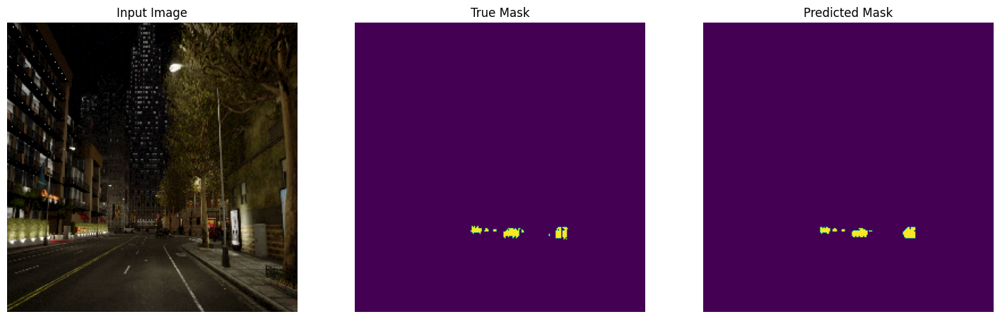

1/1 [==============================] - 0s 22ms/step


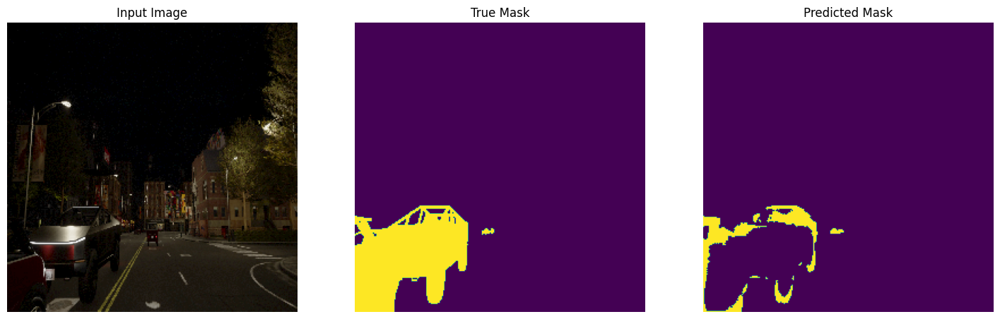

1/1 [==============================] - 0s 22ms/step


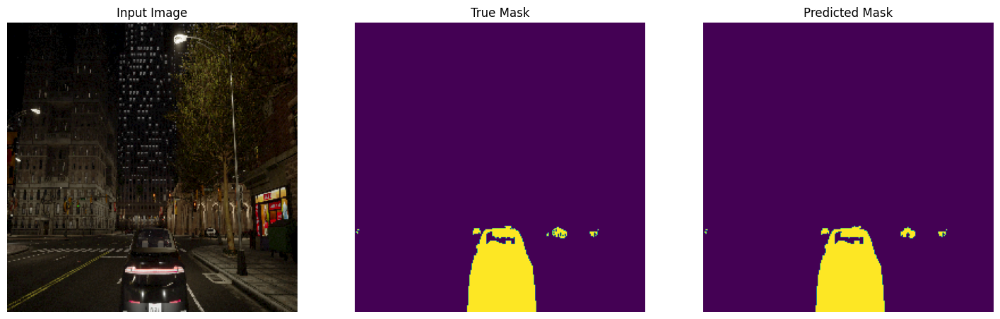

1/1 [==============================] - 0s 22ms/step


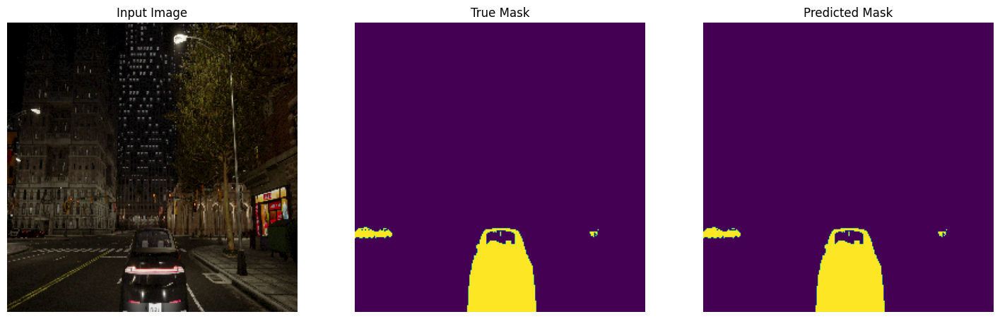

1/1 [==============================] - 0s 27ms/step


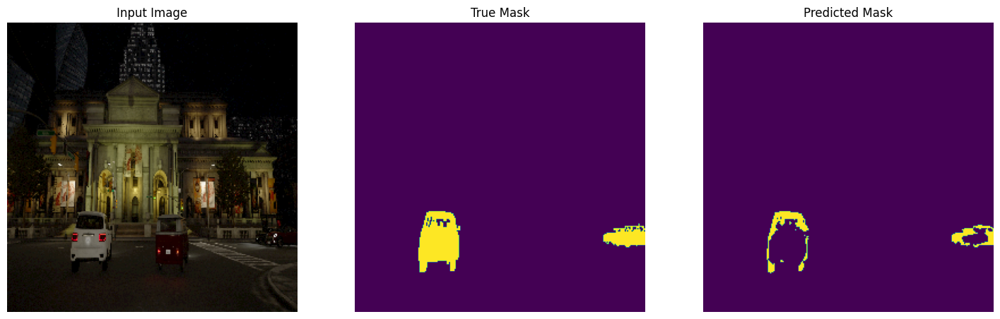

1/1 [==============================] - 0s 22ms/step


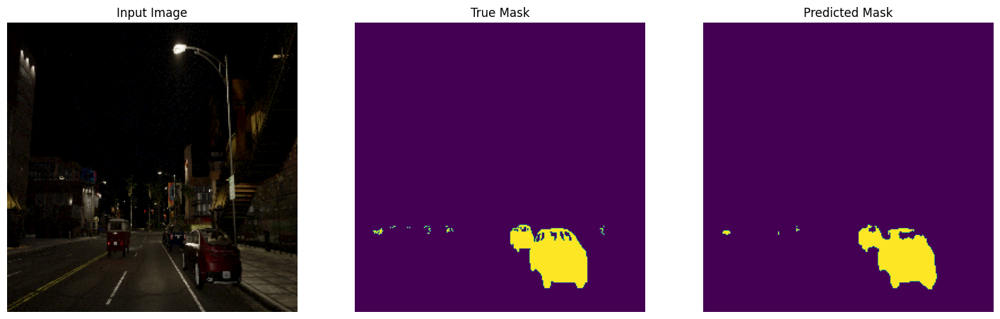

1/1 [==============================] - 0s 22ms/step


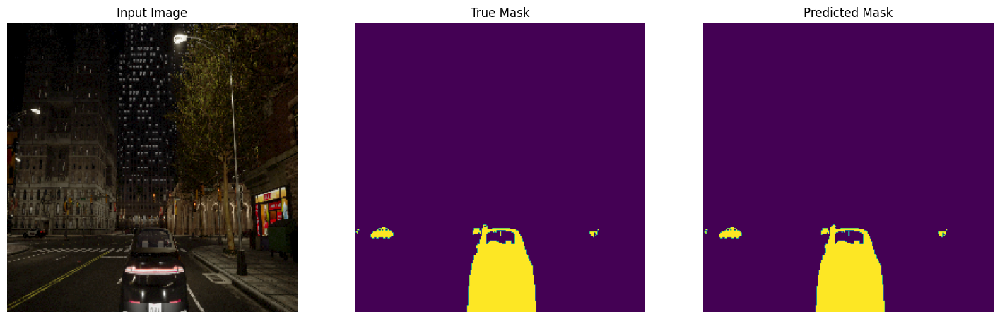

1/1 [==============================] - 0s 23ms/step


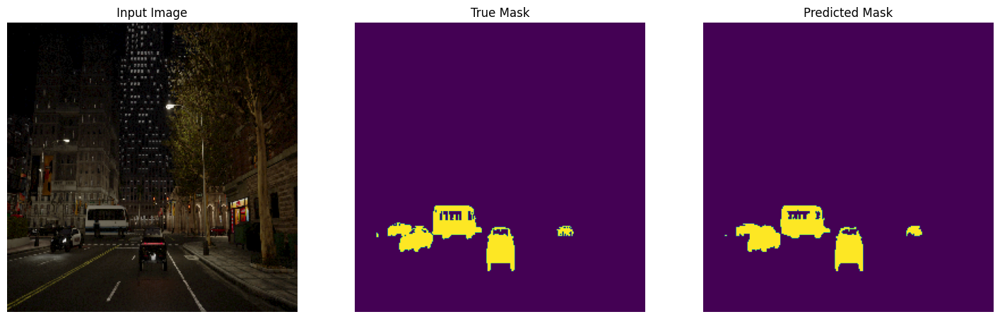

1/1 [==============================] - 0s 21ms/step


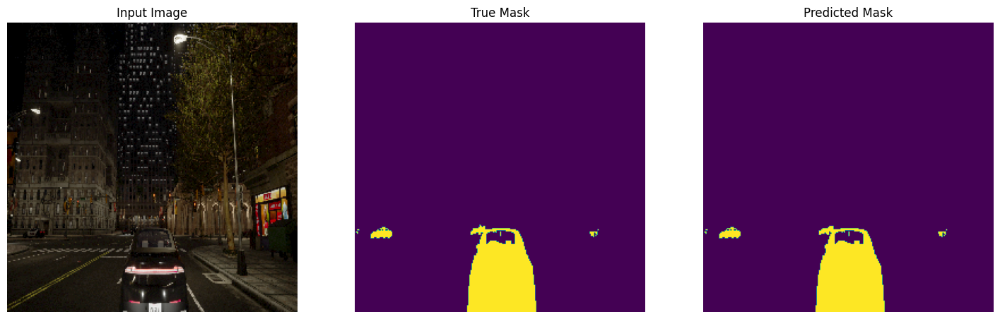

1/1 [==============================] - 0s 21ms/step


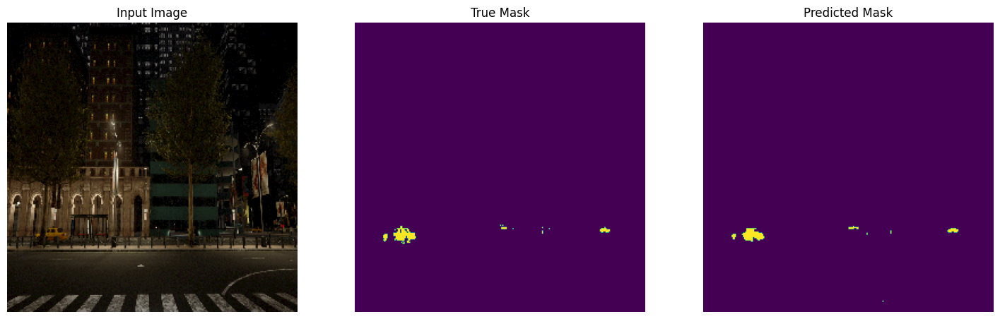

1/1 [==============================] - 0s 23ms/step


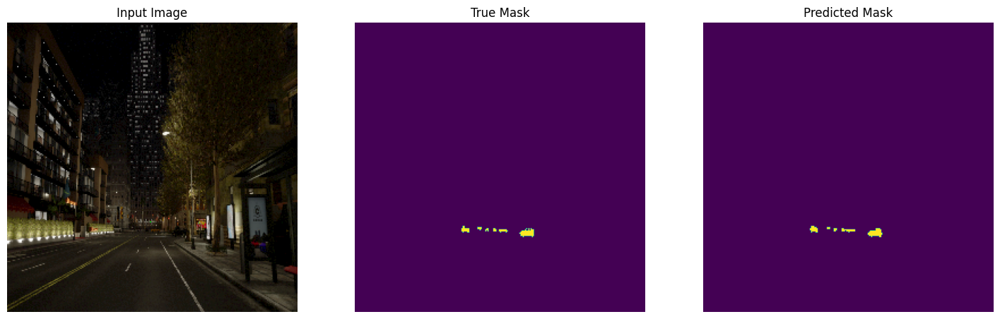

1/1 [==============================] - 0s 25ms/step


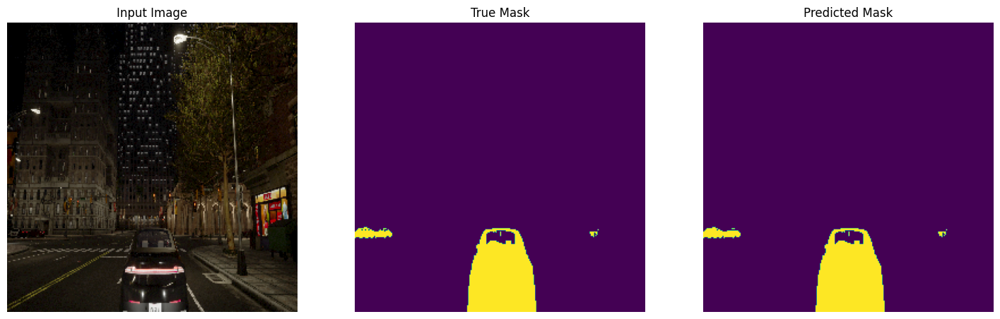

1/1 [==============================] - 0s 23ms/step


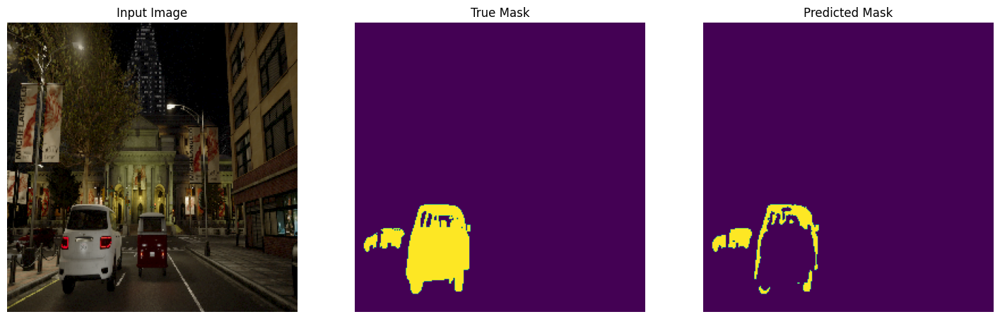

1/1 [==============================] - 0s 22ms/step


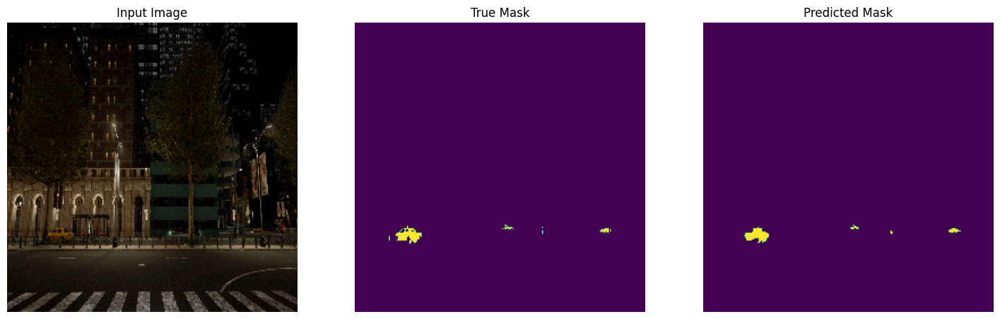

1/1 [==============================] - 0s 22ms/step


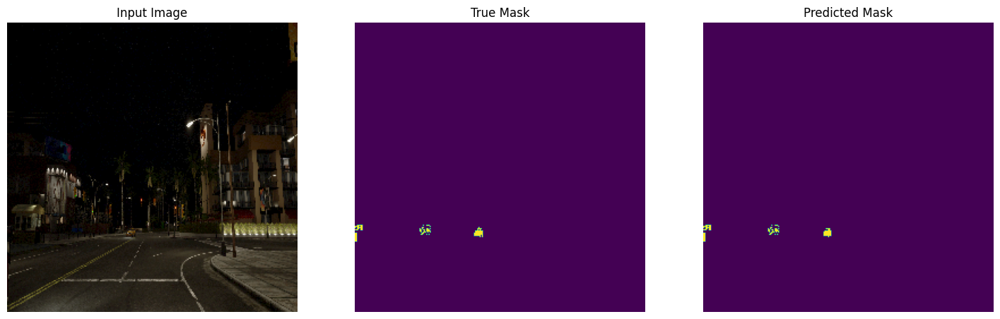

1/1 [==============================] - 0s 21ms/step


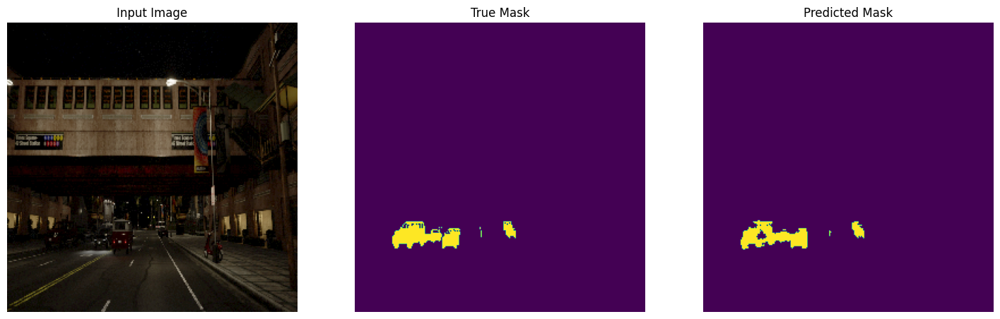

1/1 [==============================] - 0s 23ms/step


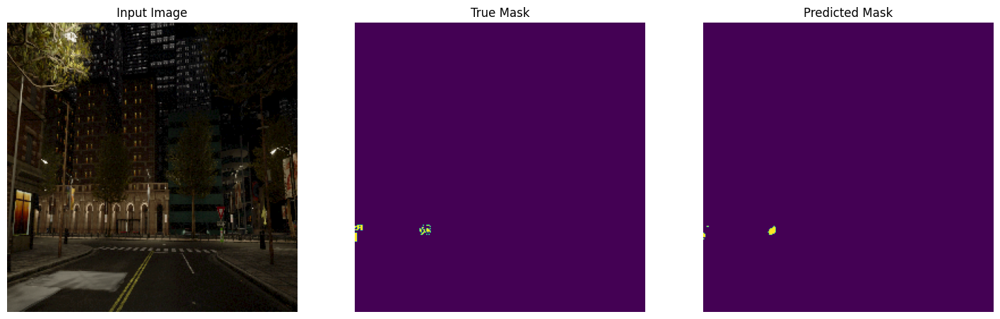

1/1 [==============================] - 0s 23ms/step


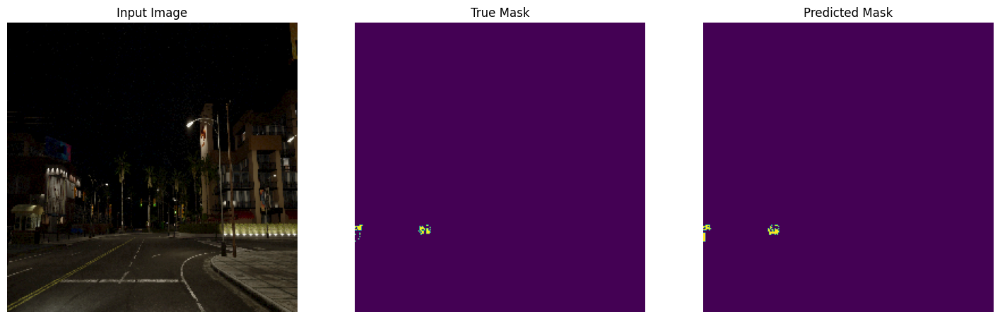

1/1 [==============================] - 0s 25ms/step


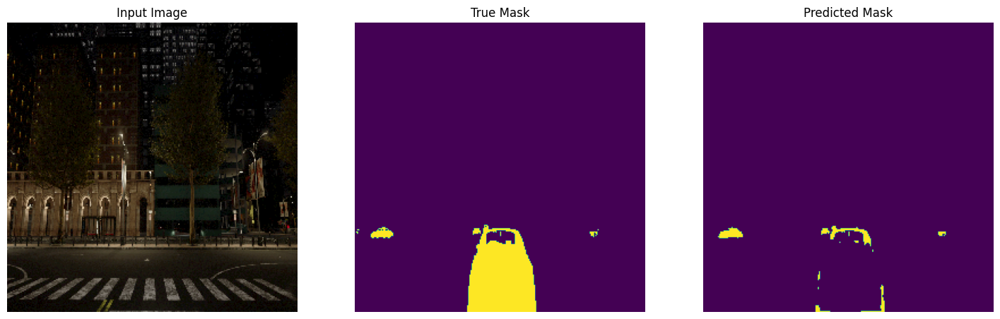

1/1 [==============================] - 0s 22ms/step


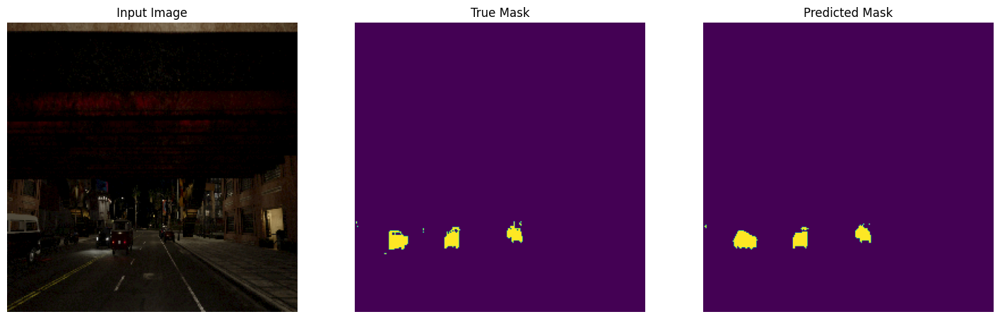

1/1 [==============================] - 0s 23ms/step


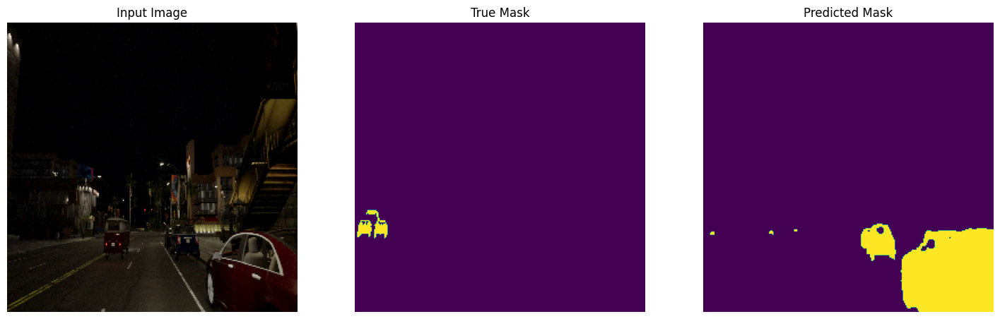

1/1 [==============================] - 0s 220ms/step


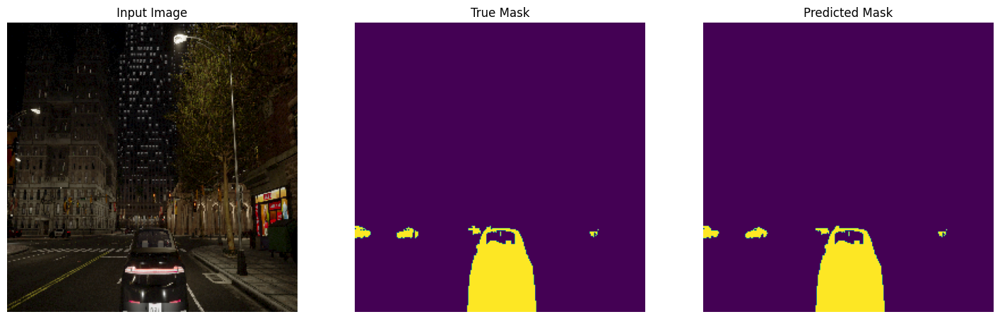

In [21]:
def show_predictions(dataset, num):
    """
    Displays the first image of each of the num batches
    """
    if dataset:
        for image, mask in dataset.take(num):
            pred_mask = modelUnet.predict(image)
            display([image[0], mask[0], create_mask(pred_mask)])
    else:
        display([sample_image, sample_mask,
             create_mask(modelUnet.predict(sample_image[tf.newaxis, ...]))])

show_predictions(testDataset,100)